In [1]:
import numpy as np
import pandas as pd
import warnings
warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt 
import seaborn as sns

In [2]:
kb = pd.read_csv('./data.csv.zip')

## 0. Kaggle Description

### 0.1: Introduction

Kobe Bryant marked his retirement from the NBA by scoring 60 points in his final game as a Los Angeles Laker on Wednesday, April 12, 2016. Drafted into the NBA at the age of 17, Kobe earned the sport’s highest accolades throughout his long career.

Using 20 years of data on Kobe's swishes and misses, can you predict which shots will find the bottom of the net? This competition is well suited for practicing classification basics, feature engineering, and time series analysis. Practice got Kobe an eight-figure contract and 5 championship rings. What will it get you?

<strong> Acknowledgements </strong>

Kaggle is hosting this competition for the data science community to use for fun and education. For more data on Kobe and other NBA greats, visit stats.nba.com.

### 0.2: The Data and Task

This data contains the location and circumstances of every field goal attempted by Kobe Bryant took during his 20-year career. Your task is to <strong> predict whether the basket went in (shot_made_flag) </strong>.

We have removed 5000 of the shot_made_flags (represented as missing values in the csv file). These are the test set shots for which you must submit a prediction. You are provided a sample submission file with the correct shot_ids needed for a valid prediction.

To avoid leakage, your method should only train on events that occurred prior to the shot for which you are predicting! Since this is a playground competition with public answers, it's up to you to abide by this rule.

### 0.3: Submission Type

For each missing shot_made_flag in the data set, you should predict a probability that Kobe made the field goal. The file should have a header and the following format:


shot_id,shot_made_flag

1,0.5

8,0.5

17,0.5

They will be evaluated through the log loss cost function.

## 1: Overview

### 1.1: Let's start with a quick overview of the data

In [3]:
kb.head()

,action_type,combined_shot_type,game_event_id,game_id,lat,loc_x,loc_y,lon,minutes_remaining,period,...,shot_type,shot_zone_area,shot_zone_basic,shot_zone_range,team_id,team_name,game_date,matchup,opponent,shot_id
0,Jump Shot,Jump Shot,10,20000012,33.9723,167,72,-118.1028,10,1,...,2PT Field Goal,Right Side(R),Mid-Range,16-24 ft.,1610612747,Los Angeles Lakers,2000-10-31,LAL @ POR,POR,1
1,Jump Shot,Jump Shot,12,20000012,34.0443,-157,0,-118.4268,10,1,...,2PT Field Goal,Left Side(L),Mid-Range,8-16 ft.,1610612747,Los Angeles Lakers,2000-10-31,LAL @ POR,POR,2
2,Jump Shot,Jump Shot,35,20000012,33.9093,-101,135,-118.3708,7,1,...,2PT Field Goal,Left Side Center(LC),Mid-Range,16-24 ft.,1610612747,Los Angeles Lakers,2000-10-31,LAL @ POR,POR,3
3,Jump Shot,Jump Shot,43,20000012,33.8693,138,175,-118.1318,6,1,...,2PT Field Goal,Right Side Center(RC),Mid-Range,16-24 ft.,1610612747,Los Angeles Lakers,2000-10-31,LAL @ POR,POR,4
4,Driving Dunk Shot,Dunk,155,20000012,34.0443,0,0,-118.2698,6,2,...,2PT Field Goal,Center(C),Restricted Area,Less Than 8 ft.,1610612747,Los Angeles Lakers,2000-10-31,LAL @ POR,POR,5


In [4]:
kb.shape

(30697, 25)

From the looks of our above table, we have some locational data, a fair number of categorical features, and the respresentation of id-based features, which are unlikely to be used later on. We seem to have a good number of total observations (not big data, but small data constrictions are unlikely). 

### 1.2: How about missing values?

In [5]:
kb.isna().sum().sum()

5000

In [6]:
kb.isna().sum().sort_values(ascending = False).head(2)

shot_made_flag    5000
shot_id              0
dtype: int64

We have 5000 missing values total; as stated in the Kaggle description, this is our test set, so we'll be sure to extract them. 

In other words, we will not have any missing values once the split occurs.

### 1.3: Misleading Values

In [7]:
kb.describe()

,game_event_id,game_id,lat,loc_x,loc_y,lon,minutes_remaining,period,playoffs,seconds_remaining,shot_distance,shot_made_flag,team_id,shot_id
count,30697.000000,3.069700e+04,30697.000000,30697.000000,30697.000000,30697.000000,30697.000000,30697.000000,30697.000000,30697.000000,30697.000000,25697.000000,3.069700e+04,30697.000000
mean,249.190800,2.476407e+07,33.953192,7.110499,91.107535,-118.262690,4.885624,2.519432,0.146562,28.365085,13.437437,0.446161,1.610613e+09,15349.000000
std,150.003712,7.755175e+06,0.087791,110.124578,87.791361,0.110125,3.449897,1.153665,0.353674,17.478949,9.374189,0.497103,0.000000e+00,8861.604943
min,2.000000,2.000001e+07,33.253300,-250.000000,-44.000000,-118.519800,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.610613e+09,1.000000
25%,110.000000,2.050008e+07,33.884300,-68.000000,4.000000,-118.337800,2.000000,1.000000,0.000000,13.000000,5.000000,0.000000,1.610613e+09,7675.000000
50%,253.000000,2.090035e+07,33.970300,0.000000,74.000000,-118.269800,5.000000,3.000000,0.000000,28.000000,15.000000,0.000000,1.610613e+09,15349.000000
75%,368.000000,2.960047e+07,34.040300,95.000000,160.000000,-118.174800,8.000000,3.000000,0.000000,43.000000,21.000000,1.000000,1.610613e+09,23023.000000
max,659.000000,4.990009e+07,34.088300,248.000000,791.000000,-118.021800,11.000000,7.000000,1.000000,59.000000,79.000000,1.000000,1.610613e+09,30697.000000


We're looking at the numeric features to find any potential outliers. This also gives us a good look at them in general. Most don't provide much relevant information; the id-based features pollute this section, and there are a few binary features that should be considered as categorical. 


An interesting result to note: the shot_distance attributed have a minimum value of 0. This could realistically happen (shots made as dunks and the like), but I want to make sure that they aren't standins for missing values.

### 1.4: Physical Distribution of Shots

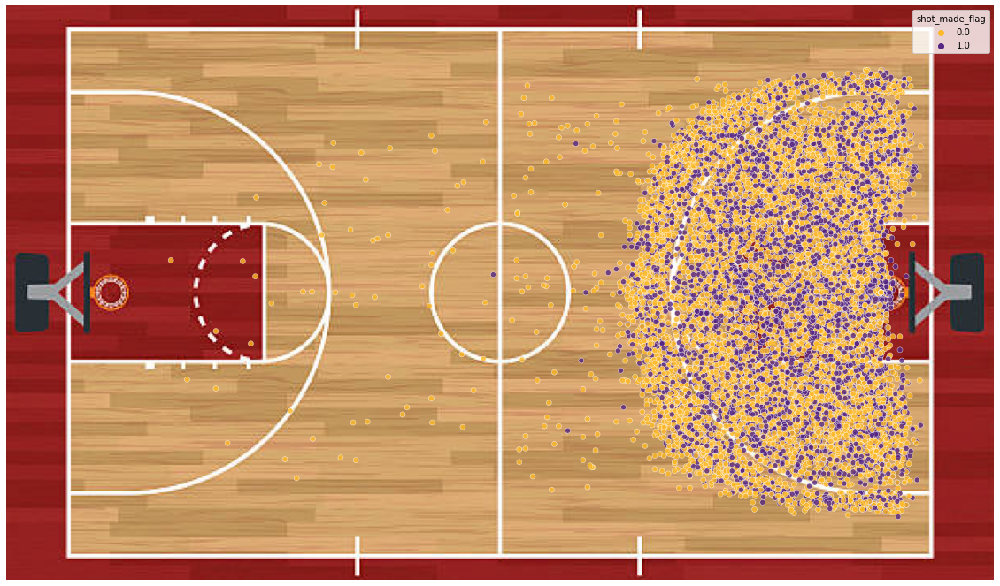

In [8]:
## Create array of Laker colors
cols = ['#FDB927','#552583']
## Transform into palette
pal = sns.color_palette(cols)

# Configure background image and figure size
plt.figure(figsize = (20,20))
img = plt.imread('bb_court.jpg')
plt.imshow(img, extent=[33.07,34.17,-118.59,-117.95])
plt.axis('off')

# plot data
sns.scatterplot(data = kb, x = 'lat', y = 'lon',  hue = 'shot_made_flag', alpha = 0.8, palette = pal);

This is the career of a professional basketball player visualized. 

Purely based on observation, it seems that Kobe performed the majority of his shots from within the three-point line. It also looks like there is no clear relationship between his successful shots and where along the extended free throw line he was (i.e his location along the y-axis did not seem to matter). 

### 1.5: The Target Feature

In [9]:
kb.shot_made_flag.value_counts()

0.0    14232
1.0    11465
Name: shot_made_flag, dtype: int64

Ignoring the observations in the test set, it seems that Kobe missed slightly more shots than he made, averaging around a 44.6% shot completion rate. As is expected, the target feature calls for binary classification, and there is no need for any form of transformation.

## 2: Splitting the Data

### 2.1: Separate Testing Set Based on Aforementioned Kaggle Requirements

In [10]:
## Find observations with missing shot_made_flag values
test_index = kb[kb.shot_made_flag != kb.shot_made_flag].index

## split between overall train and testing sets
train = kb.drop(index=test_index)
test = kb.loc[test_index]

## Break further into X and y for each
Xtr, ytr = train.drop(['shot_made_flag'], axis = 1), train.shot_made_flag
Xte, yte = test.drop(['shot_made_flag'], axis = 1), test.shot_made_flag

Now that we have our training and testing sets, we can safely perform some EDA.

## 3: Exploratory Data Analysis (EDA)

### 3.1: Shot Distance

Let's look at my prior concerns about potential irregularities in the shot_distance feature. 

Remember that the lowest value was zero, which I was worried may have been a standin for a missing value. That said, it is more likely that these values represent dunks made by Kobe. We'll be making sure. 

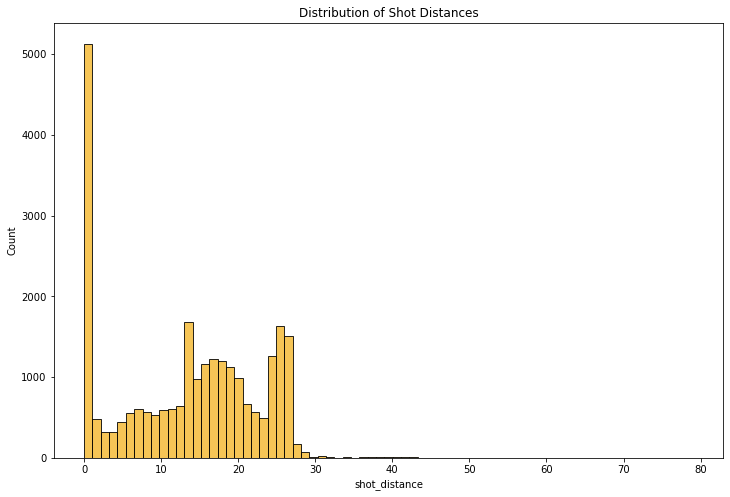

In [15]:
plt.figure(figsize=(12,8))
sns.histplot(Xtr.shot_distance, color = '#F3B21D')
plt.title("Distribution of Shot Distances");

Its clear that most of the our shots occurred from at the net. These can include dunks, layups, and close shots. Let's get a little bit of accounting done.

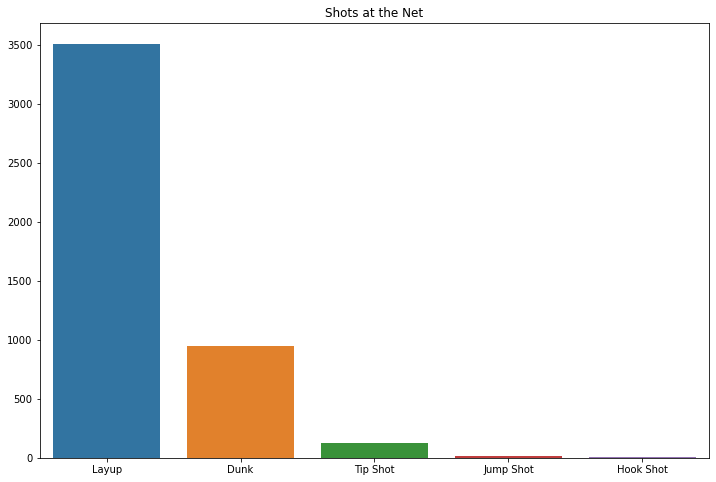

In [16]:
temp = Xtr[Xtr['shot_distance'] == 0]['combined_shot_type'].value_counts()
plt.figure(figsize = (12,8))
sns.barplot(x = temp.index, y = temp.values)
plt.title("Shots at the Net");

After looking at the type of shots that had occurred at the net (i.e. with a distance of 0), you can tell that those values are genuine rather than missing. As surmised, layups and dunks accounted for the vast majority of the close shots, so they are definitely not standins for missing values.

### That being said, how does the shot's distance relate to its scoring chance?

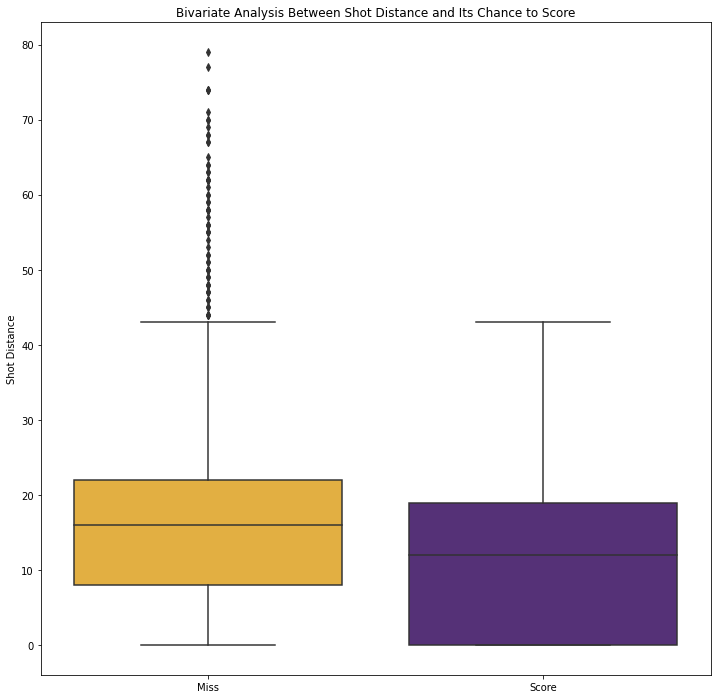

In [19]:
pal = sns.color_palette(cols)
plt.figure(figsize=(12,12))
sns.boxplot(x = np.where(ytr == 1, 'Score', 'Miss'), y = Xtr.shot_distance, palette=pal)
plt.ylabel("Shot Distance")
plt.title('Bivariate Analysis Between Shot Distance and Its Chance to Score');

Knowing even a little bit about basketball, you could likely guess that a shot's distance influenced whether or not it would be a field goal or miss. This boxplot just confirms that relationship. Shots made closer to the net are far more likely to succeed than those attempted from farther away. 

In addition, according to the data, shots attempted from more than 45 feet never succeeded.

### 3.2: Action Type vs Combined Shot Type

Next up we have two categorical features; at first blush, action shot and shot type seem very similar since both essentially describe the type of shot performed by Kobe. If they do overlap to this degree, then we'll need to choose one or the other later on.

### 3.2.1: Problems with Action Type

Let's look at both:

In [20]:
action_crosstab = pd.crosstab(index = Xtr.action_type, columns = np.where(ytr == 1, 'Score', 'Miss')).sort_values(by = 'Score', ascending = False)
temp = pd.melt(action_crosstab.reset_index(), id_vars= ['action_type'], value_vars = ['Score','Miss']).sort_values(by = ['value','action_type'], ascending = False).head(20)

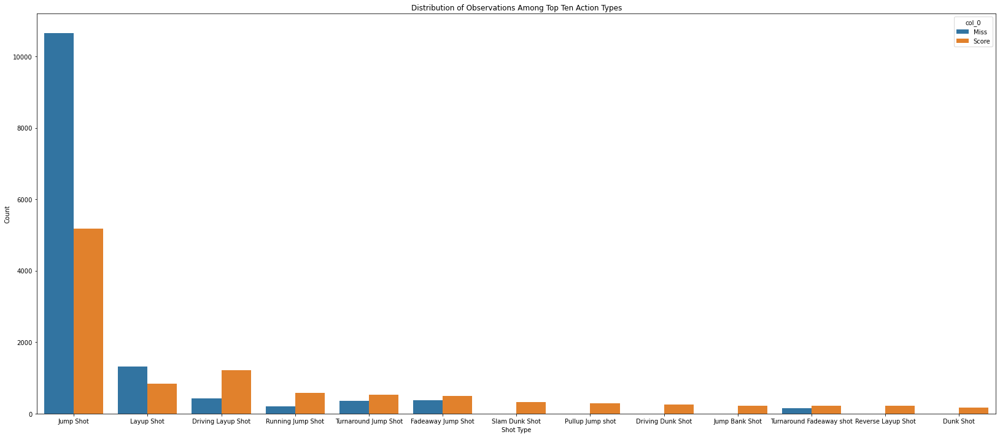

In [21]:
plt.figure(figsize = (28,12))
sns.barplot(data = temp, x = 'action_type', y = 'value', hue = 'col_0')
plt.xlabel("Shot Type")
plt.ylabel("Count")
plt.title("Distribution of Observations Among Top Ten Action Types");

From this point onwards, the distribution has an ever longer tail until we get to categories that consist of one observations. This is a skewed distribution at the end of the day.

The problem with this attribute is that there are so many useless categories, each of which will end up becoming a dimension when modeling. This would cripple performance and harm the predictive power of many models. As such, adding it would be problematic.

### 3.2.2: Problems with Combined Shot Types

In [22]:
combo_crosstab = pd.crosstab(index = Xtr.combined_shot_type, columns = np.where(ytr == 1, 'Score', 'Miss')).sort_values(by = 'Score', ascending = False)
temp = pd.melt(combo_crosstab.reset_index(), id_vars= ['combined_shot_type'], value_vars = ['Score','Miss']).sort_values(by = ['value','combined_shot_type'], ascending = False)

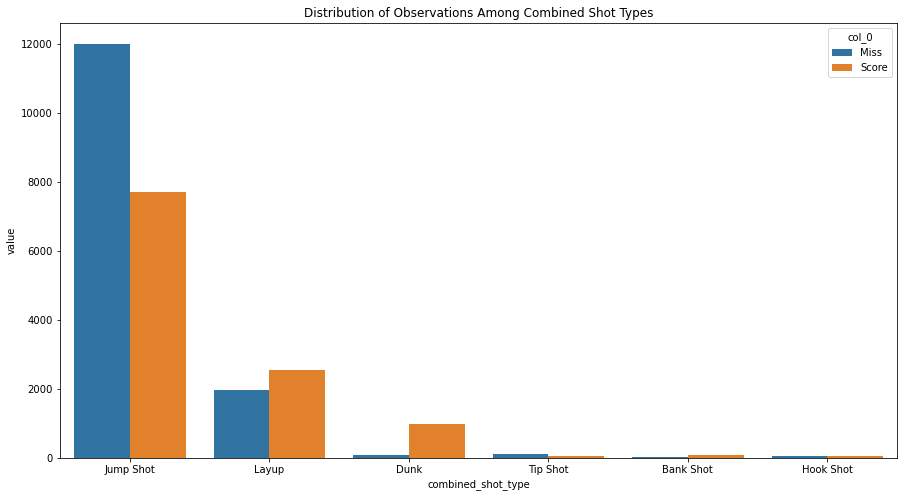

In [23]:
plt.figure(figsize = (15,8))
sns.barplot(data = temp, x = 'combined_shot_type', y = 'value', hue = 'col_0')
plt.title('Distribution of Observations Among Combined Shot Types');

As the name suggests, this attribute combines the categories of the prior setup. 

Although it has fewer categories, it does suffer from the fact that aggregates too much. We'll see below.

In [51]:
tempy = pd.concat((action_crosstab.iloc[1:3,:],pd.DataFrame(combo_crosstab.iloc[1,:]).T), axis = 0)
tempy.reset_index(inplace = True)
tempy = pd.melt(tempy, id_vars=['index'],value_vars=['Miss','Score'])

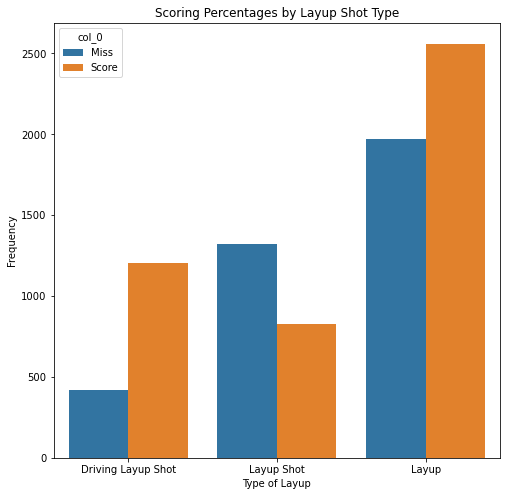

In [53]:
plt.figure(figsize=(8,8))
sns.barplot(data = tempy,x = 'index' ,y= 'value', hue='col_0')
plt.xlabel('Type of Layup')
plt.ylabel("Frequency")
plt.title("Scoring Percentages by Layup Shot Type");

Above you see different styles of layup and the generalized version to the right. The Driving Layup Shot and Normal Layup Shot are both heavily weighted towards either missing or scoring. The aggregated layup is less polarized. 

### 3.2.3: Solution

We need to make our own version of the Combined Shot Type feature that avoids being too generalized or having that long-tail problem. 

Step 1: Identify which action types are mapped to which combined shot types
Step 2: Run through the distribution for each set of action types relative to each combined shot type
Step 3: Combine like action types within a combined shot type category

In [54]:
temp = Xtr[['action_type','combined_shot_type']]
temp['combo'] = [x + ',' + y for x, y in zip(Xtr['action_type'],Xtr['combined_shot_type'])]
unique_combos = pd.DataFrame(temp['combo'].unique(), columns=[''])
unique_combos.columns = ['Combined']
unique_combos['Combined'] = unique_combos.Combined.str.split(',')

In [55]:
unique_combos = pd.DataFrame(unique_combos['Combined'].tolist(), columns=['action_type','combined_shot_type'])
unique_combos.sort_values(by = ['combined_shot_type','action_type'], inplace=True)

In [71]:
def show_dist(shot_type):
    base = unique_combos[unique_combos.combined_shot_type == shot_type]['action_type'].tolist()

    improved = action_crosstab[action_crosstab.index.isin(base)]
    improved['Score_Pct'] = improved.Score/(improved.Miss + improved.Score)
    improved['Pct_of_Total'] = (improved.Score + improved.Miss)/len(Xtr)

    improved_show = pd.melt(improved.reset_index(), id_vars=['action_type'], value_vars=['Miss','Score'])

    plt.figure(figsize=(30,10))
    sns.barplot(data = improved_show, x = 'action_type', y = 'value', hue = 'col_0')
    plt.title("Hit and Miss For Kobe {} Types".format(shot_type))
    
    return  improved.sort_values(by = 'Score_Pct', ascending = False);

### Jump Shot

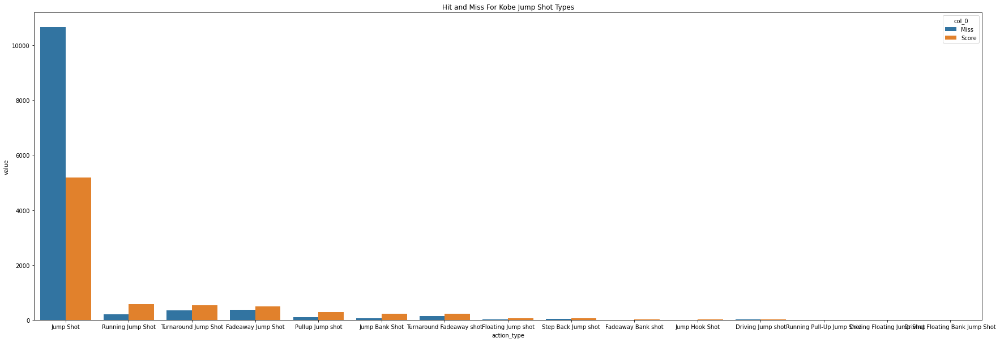

In [72]:
jumps = show_dist('Jump Shot')

In [73]:
jumps

col_0,Miss,Score,Score_Pct,Pct_of_Total
action_type,,,,
Driving Floating Bank Jump Shot,0,1,1.000000,0.000039
Fadeaway Bank shot,3,24,0.888889,0.001051
Jump Bank Shot,65,224,0.775087,0.011246
Running Jump Shot,197,582,0.747112,0.030315
Jump Hook Shot,5,14,0.736842,0.000739
Pullup Jump shot,111,291,0.723881,0.015644
Floating Jump shot,26,67,0.720430,0.003619
Running Pull-Up Jump Shot,1,2,0.666667,0.000117
Step Back Jump shot,39,67,0.632075,0.004125


### Layup Shot

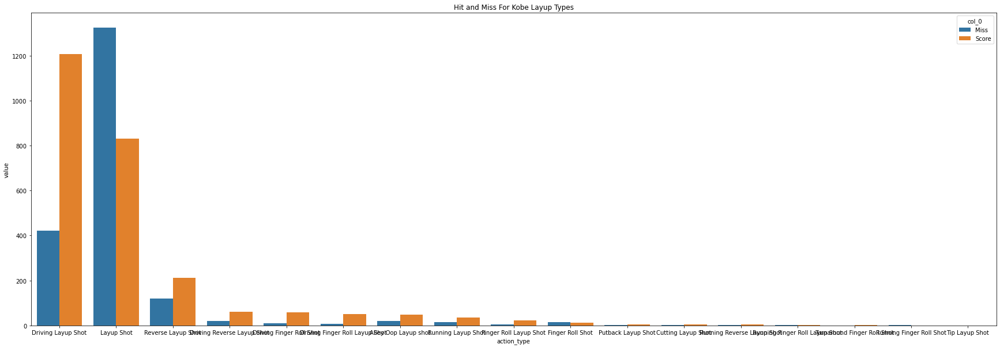

In [74]:
layups = show_dist("Layup")

In [75]:
layups

col_0,Miss,Score,Score_Pct,Pct_of_Total
action_type,,,,
Turnaround Finger Roll Shot,0,2,1.000000,0.000078
Driving Finger Roll Layup Shot,7,52,0.881356,0.002296
Driving Finger Roll Shot,10,58,0.852941,0.002646
Finger Roll Layup Shot,5,23,0.821429,0.001090
Driving Reverse Layup Shot,21,62,0.746988,0.003230
Driving Layup Shot,421,1207,0.741400,0.063354
Alley Oop Layup shot,19,48,0.716418,0.002607
Running Layup Shot,15,36,0.705882,0.001985
Putback Layup Shot,3,6,0.666667,0.000350


### Dunks

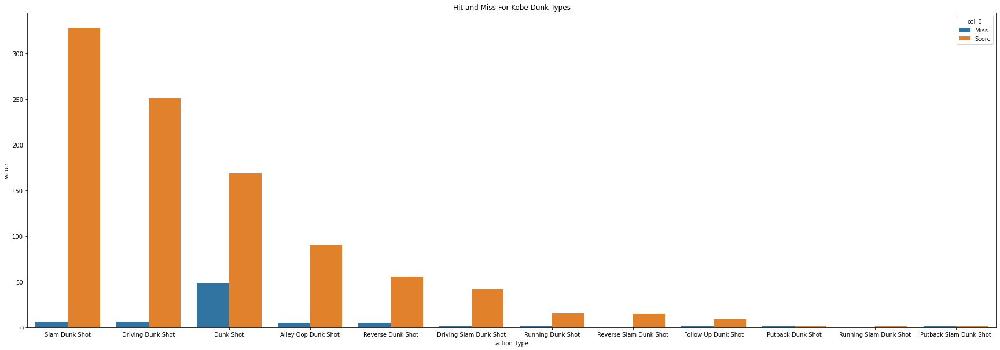

In [77]:
dunks = show_dist('Dunk')

In [78]:
dunks

col_0,Miss,Score,Score_Pct,Pct_of_Total
action_type,,,,
Reverse Slam Dunk Shot,0,15,1.000000,0.000584
Running Slam Dunk Shot,0,1,1.000000,0.000039
Slam Dunk Shot,6,328,0.982036,0.012998
Driving Slam Dunk Shot,1,42,0.976744,0.001673
Driving Dunk Shot,6,251,0.976654,0.010001
Alley Oop Dunk Shot,5,90,0.947368,0.003697
Reverse Dunk Shot,5,56,0.918033,0.002374
Follow Up Dunk Shot,1,9,0.900000,0.000389
Running Dunk Shot,2,16,0.888889,0.000700


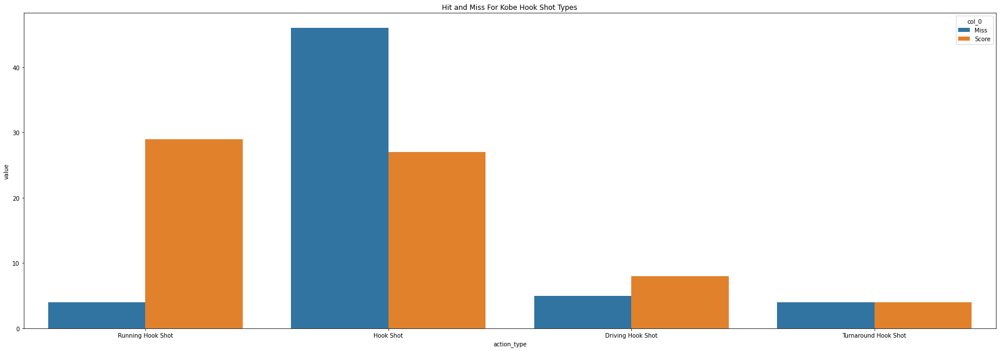

In [79]:
hooky = show_dist('Hook Shot')

In [80]:
hooky

col_0,Miss,Score,Score_Pct,Pct_of_Total
action_type,,,,
Running Hook Shot,4,29,0.878788,0.001284
Driving Hook Shot,5,8,0.615385,0.000506
Turnaround Hook Shot,4,4,0.500000,0.000311
Hook Shot,46,27,0.369863,0.002841


### 3.3: Shot Type

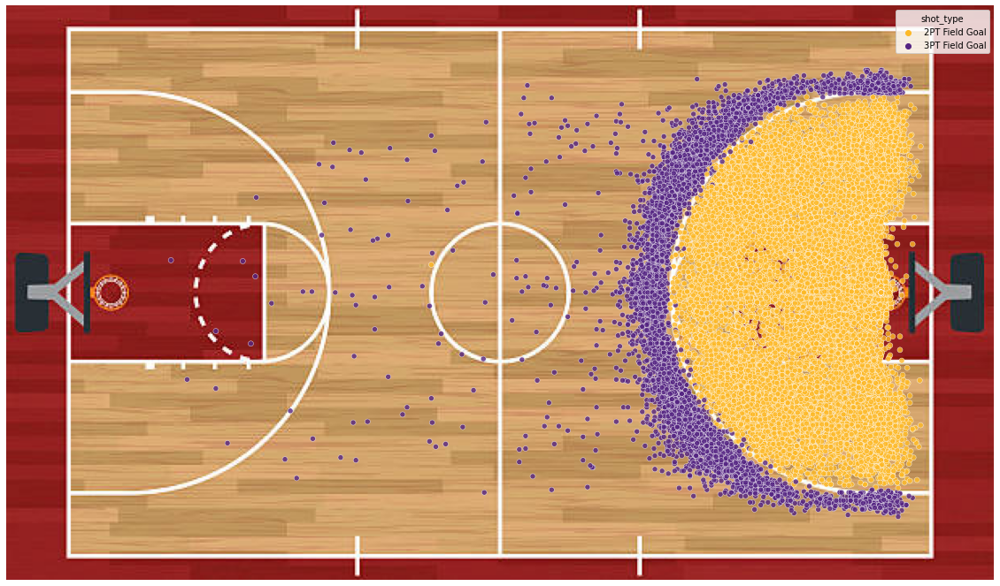

In [21]:
## Create array of Laker colors
cols = ['#FDB927','#552583']
## Transform into palette
pal = sns.color_palette(cols)

# Configure background image and figure size
plt.figure(figsize = (20,20))
img = plt.imread('bb_court.jpg')
plt.imshow(img, extent=[33.07,34.17,-118.59,-117.95])
plt.axis('off')

# plot data
sns.scatterplot(data = kb, x = 'lat', y = 'lon',  hue = 'shot_type', alpha = 0.8, palette = pal);

In [22]:
pd.crosstab(index = Xtr.shot_type, columns = np.where(ytr == 1, 'Score', 'Miss')).sort_values(by = 'Score', ascending = False)

col_0,Miss,Score
shot_type,,
2PT Field Goal,10602,9683
3PT Field Goal,3630,1782


I'm bringing back our prior image to showcase this feature. 

Although there is a clear connection between the type of shot made and its percent chance to become a field goal, there is also a relationship between it and the shot distance showcased earlier. The two features are covariant, meaning this feature will be dropped later on.

### 3.4: Shot Zone Area

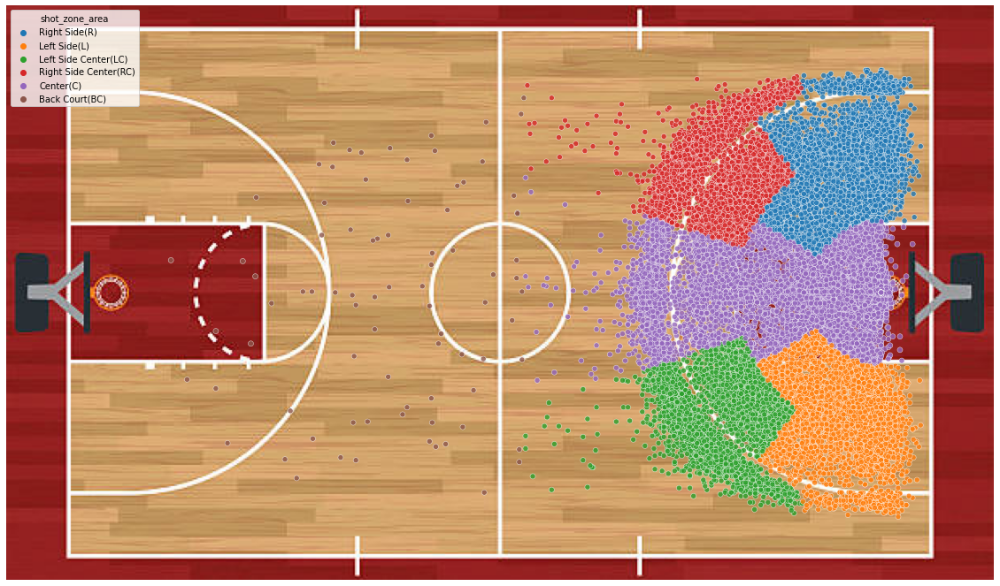

In [23]:
# Configure background image and figure size
plt.figure(figsize = (20,20))
img = plt.imread('bb_court.jpg')
plt.imshow(img, extent=[33.07,34.17,-118.59,-117.95])
plt.axis('off')

# plot data
sns.scatterplot(data = kb, x = 'lat', y = 'lon',  hue = 'shot_zone_area', alpha = 0.8);

In [24]:
pd.crosstab(index = Xtr.shot_zone_area, columns = np.where(ytr == 1, 'Score', 'Miss')).sort_values(by = 'Score', ascending = False)

col_0,Miss,Score
shot_zone_area,,
Center(C),5356,5933
Right Side(R),2309,1550
Right Side Center(RC),2458,1523
Left Side(L),1889,1243
Left Side Center(LC),2149,1215
Back Court(BC),71,1


Although this feature suffers from the same potential for covariance with shot distance that shot type did, this variable differentiates itself by incorporating the shot angle into the equation. That aspect is not naturally within this dataset.

For example, it's clear that Kobe managed greater success when shooting from the center rather than the left or right, despite the fact that they (mostly) were taken from comparable ranges. 

We end up creating a shot angle feature later on, which covers the information relayed by this attribute, so we will keep this away from the model.

## 4: Feature Engineering and Selection

Although we've run through and selected (or disqualified) a few features, those decisions were pretty straightforward, and they were direct byproducts of my exploratory data analysis. In this next section, we will be looking through other attributes that either need to be altered or have a more complicated relationship with others in the set.

### 4.1: Season and Game Date

In [25]:
temp = pd.concat((Xtr[['season','game_date']], ytr), axis = 1)
temp.head()

,season,game_date,shot_made_flag
1,2000-01,2000-10-31,0.0
2,2000-01,2000-10-31,1.0
3,2000-01,2000-10-31,0.0
4,2000-01,2000-10-31,1.0
5,2000-01,2000-10-31,0.0


Here we have two features that represent a similar aspect of Kobe's performance, specifically when throughout his career he made a shot. Season represents this as a categorical feature while game date does so more continuously. 

Before investigating though, we'll be cleaning these two features by breaking them down into their parts.

In [26]:
temp['game_date'] = pd.to_datetime(temp['game_date'])
temp['score_pct'] = temp.groupby('game_date')['shot_made_flag'].transform('mean')
temp['shot_count'] = temp.groupby('game_date')['shot_made_flag'].transform('size')
temp['year'] = temp.game_date.dt.year
temp['month'] = temp.game_date.dt.month
temp.sort_values('game_date').head()

,season,game_date,shot_made_flag,score_pct,shot_count,year,month
22901,1996-97,1996-11-03,0.0,0.000000,1,1996,11
22902,1996-97,1996-11-05,0.0,0.000000,1,1996,11
22903,1996-97,1996-11-06,1.0,0.666667,3,1996,11
22904,1996-97,1996-11-06,0.0,0.666667,3,1996,11
22905,1996-97,1996-11-06,1.0,0.666667,3,1996,11


Now that everything has been disassembled, we'll treat this as a time series, meaning we will look for trends and seasonality. Two questions to keep in mind:

1. How did Kobe's shot count change depending on the year?
2. How did his accuracy change, and how did the shot count play a role in it?

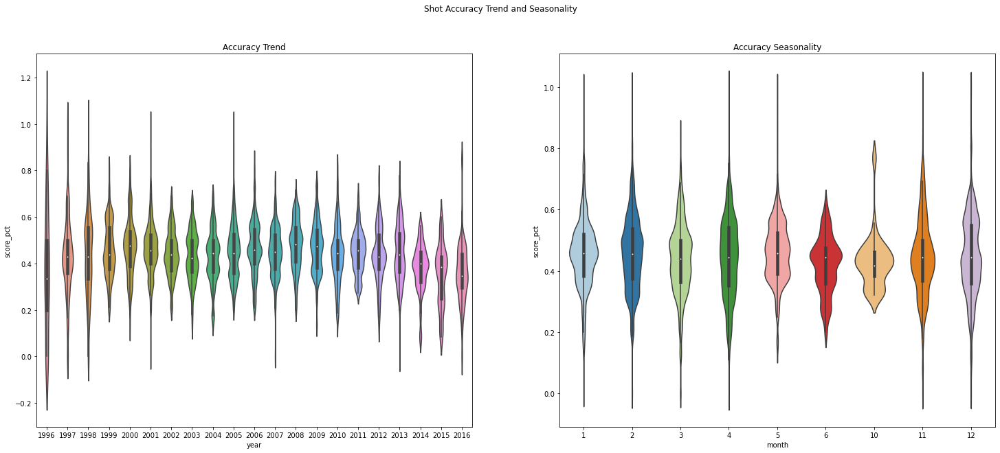

In [27]:
fig, (ax, ax2) = plt.subplots(1,2, figsize = (25,10))
sns.set_palette(sns.color_palette("Paired"))
sns.violinplot(data = temp, x = 'year', y = 'score_pct', ax = ax)
sns.violinplot(data = temp, x = 'month', y = 'score_pct', ax = ax2)
plt.suptitle("Shot Accuracy Trend and Seasonality")
ax.title.set_text('Accuracy Trend')
ax2.title.set_text("Accuracy Seasonality");

This visualization provides some clear answers to our prior answers earlier:

1. Towards the beginning and end of his career, he took less shots when compared to the middle of his career.
2. The accuracy could be generally described as consistent from 1999 to 2013. Before 1999, the variance of per-game accuracy was wild due to the low number of shots taken per game (lots of 100% and 0% there). After 2013, you can see a drop in accuracy, likely caused by injuries taken during the brutal 2013 season. 

Generally, there seems to be no seasonality. Kobe, professionally, did not care much whether or not it was November or March. 

In short, this set of features can be boiled down to the predictive power of the season Kobe played in. Let's look closer at it. 

In [28]:
temp = pd.crosstab(index = temp.year, columns = np.where(ytr == 1, 'Score', 'Miss'))
temp['Ratio'] = temp['Score']/(temp['Miss'] + temp['Score'])
temp.Ratio.describe()

count    21.000000
mean      0.433984
std       0.036569
min       0.348884
25%       0.430400
50%       0.441935
75%       0.460834
max       0.476932
Name: Ratio, dtype: float64

It seems that the late-90s and early 2000s were pretty good years for Kobe's accuracy. There's a decent range invovled with this feature, but the deviation is not that high. We'll keep the season feature for the model, but the game date and the seasonality components can be dropped.

### 4.2: What About Playoffs?

In [29]:
temp = pd.crosstab(index = Xtr.playoffs, columns = np.where(ytr == 1, 'Score', 'Miss')).sort_values(by = 'Score', ascending = False)
temp['Ratio'] = temp['Score']/(temp['Miss'] + temp['Score'])
temp

col_0,Miss,Score,Ratio
playoffs,,,
0,12145,9794,0.446420
1,2087,1671,0.444651


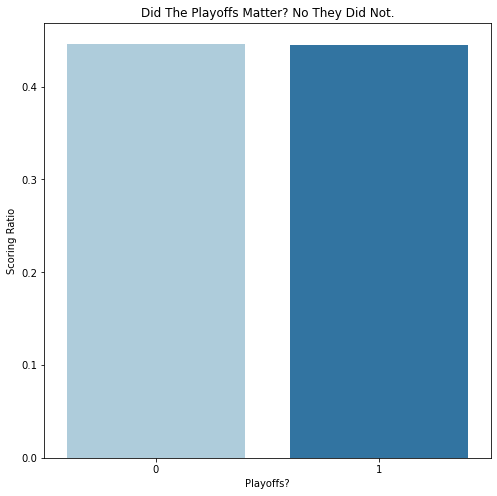

In [30]:
plt.figure(figsize = (8,8))
sns.barplot(x = temp.index, y = temp.Ratio)
plt.xlabel("Playoffs?")
plt.ylabel("Scoring Ratio")
plt.title("Did The Playoffs Matter? No They Did Not.");

Generally, Kobe didn't seem to be affected by playoff pressure. These results would push us towards getting rid of the feature as a predictive variable.

### 4.3: In-Game Temporal Features

Our next features are all connected in that they describe the points during individual games that Kobe made or missed a shot. What's interesting about these features is that there is an argument to both combine them into one overall clock and not to. 

For: Combinging them all into one would allow us to track shots continuously throughout the game.

Against: This is not exactly how basketball works; shots are more likely to happen as the timer runs down, especially as the number of periods drags on. A continuous clock would falter when explaining hopeful shots made just before halftime and the like.

In [31]:
temp = Xtr[['minutes_remaining','period','seconds_remaining']]
temp.head()

,minutes_remaining,period,seconds_remaining
1,10,1,22
2,7,1,45
3,6,1,52
4,6,2,19
5,9,3,32


Continuous intervals interrupted by quarter starts and stops seems to be the best way forward. I will merge the minutes and seconds features into one but leave the quarter variable alone. In short, I will be treating this also like a time series.

In [32]:
temp['seconds_remaining_in_quarter'] = (pd.to_numeric(temp['minutes_remaining'])*60)+(pd.to_numeric(temp['seconds_remaining']))
temp = pd.concat((temp, ytr), axis = 1)
temp['score_pct'] = temp.groupby('minutes_remaining')['shot_made_flag'].transform('mean')
temp[['period','seconds_remaining_in_quarter','shot_made_flag','score_pct']].head()

,period,seconds_remaining_in_quarter,shot_made_flag,score_pct
1,1,622,0.0,0.454950
2,1,465,1.0,0.481876
3,1,412,0.0,0.469965
4,2,379,1.0,0.469965
5,3,572,0.0,0.479744


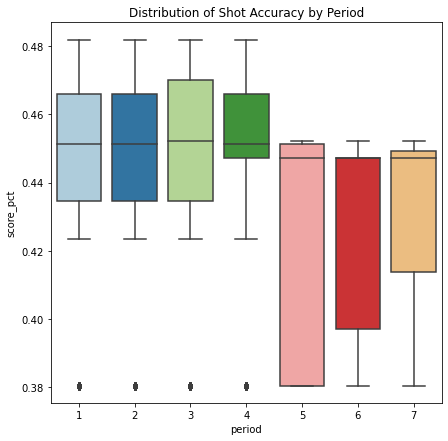

In [33]:
plt.figure(figsize = (7,7))
sns.boxplot(x = temp['period'], y = temp['score_pct'])
plt.title("Distribution of Shot Accuracy by Period");

There's a clear difference in shot quality by period, primarily between "normal" periods and irregular ones. 

How does the minute marker affect performance?

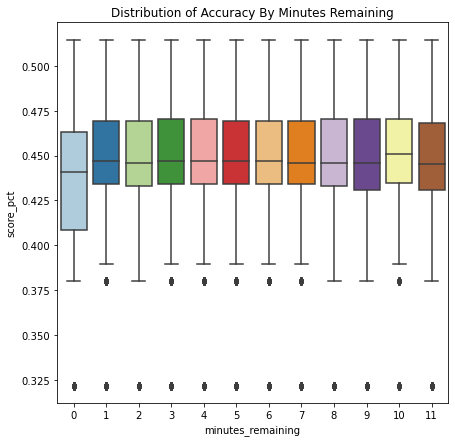

In [34]:
temp['score_pct'] = temp.groupby('seconds_remaining')['shot_made_flag'].transform('mean')

plt.figure(figsize=(7,7))
sns.boxplot(x = temp['minutes_remaining'], y = temp['score_pct'])
plt.title("Distribution of Accuracy By Minutes Remaining");

We seem to have reasonably consistent performance across minutes throughout a quarter with one exception. As the last minute runs down, the accuracy suffers. 

Remember that many shots were attempted in the last second; these would reasonably have a lower accuracy than their normal counterparts, so we should create a feature that differentiates the two. 

### 4.4: Last-Second Shot

In [35]:
last_second = Xtr[(Xtr['seconds_remaining'] == 0) & (Xtr['minutes_remaining'] == 0)]
last_second_shot = ytr.loc[last_second.index]

temp = pd.concat((last_second, last_second_shot), axis = 1)

In [36]:
second = temp.shot_made_flag.mean()
second

0.18036529680365296

The average scoring rate for shots made in the last second are just under 20%. This is a clear drop in accuracy from the general average, but we are representing a small subsection of the total population (~600 vs. 36000). 

What if we check how all shots in the final minute compare?

In [37]:
last_minute = Xtr[Xtr['minutes_remaining'] == 0]
last_minute_shot = ytr.loc[last_minute.index]

temp = pd.concat((last_minute, last_minute_shot), axis = 1)

In [38]:
minute = temp.shot_made_flag.mean()
minute

0.3805418719211823

The average scoring rate for shots made in the last minute is significantly higher than the last second but not as high as the general average. This makes intuitive sense since the last minute is a middle ground between normal play and a desperate shot at the last second. 

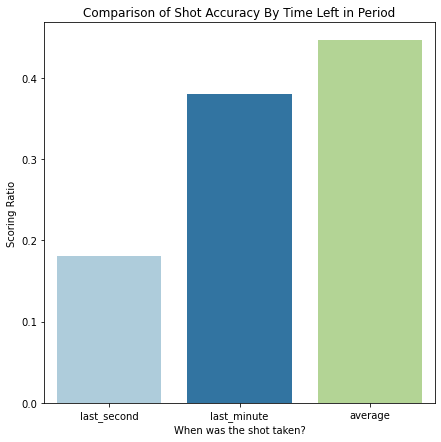

In [39]:
plt.figure(figsize = (7,7))
sns.barplot(x = ['last_second', 'last_minute', 'average'], y = [second, minute, ytr.mean()])
plt.xlabel("When was the shot taken?")
plt.ylabel('Scoring Ratio')
plt.title("Comparison of Shot Accuracy By Time Left in Period");

It seems that both the last second and last minute shots would be beneficial in classifying a shot as being a field goal or a miss, but they would likely have a fair degree of covariance. Let's see if its a problem.

In [40]:
temp1 = pd.Series(np.where((Xtr['seconds_remaining'] == 0) & (Xtr['minutes_remaining'] == 0), 1, 0))
temp2 = pd.Series(np.where(Xtr['minutes_remaining'] == 0, 1, 0))

pd.concat((temp1, temp2), axis = 1).corr()

,0,1
0,1.000000,0.346194
1,0.346194,1.000000


With a correlation of 0.35, they have a little bit of covariance but not enough to be considered problematic alone. We'll add both features.

### 4.5: Game Location

Next up, how does the game's location affect Kobe's shot performance? Does he have a home turf advantage?

In [41]:
temp = pd.concat((Xtr['matchup'], ytr), axis = 1)
temp['game_loc'] = np.where(Xtr['matchup'].str.contains('@'), 0, 1)

In [42]:
temp.head()

,matchup,shot_made_flag,game_loc
1,LAL @ POR,0.0,0
2,LAL @ POR,1.0,0
3,LAL @ POR,0.0,0
4,LAL @ POR,1.0,0
5,LAL @ POR,0.0,0


In [43]:
temp = pd.crosstab(temp['game_loc'], temp['shot_made_flag'])
temp['score_pct'] = temp.loc[:,1]/(temp.loc[:,1]+temp.loc[:,0])
temp

shot_made_flag,0.0,1.0,score_pct
game_loc,,,
0,7446,5766,0.436421
1,6786,5699,0.456468


Surprisingly, there does not seem to be a difference between Kobe's performance away versus at home. 

### 4.6: Opponent Quality

The quality of the opposing team is also a theoretical factor for the number of shots Kobe would make versus miss. 

In [44]:
temp = pd.concat((Xtr, ytr), axis = 1)
temp['score_pct_by_game'] = temp.groupby('game_event_id')['shot_made_flag'].transform('mean')
temp['score_pct'] = temp.groupby('opponent')['shot_made_flag'].transform('mean')
temp[['opponent','score_pct']].drop_duplicates().sort_values('score_pct').head()

,opponent,score_pct
19587,BKN,0.400000
293,IND,0.400958
6279,NOP,0.407666
501,MIL,0.410256
2534,BOS,0.411239


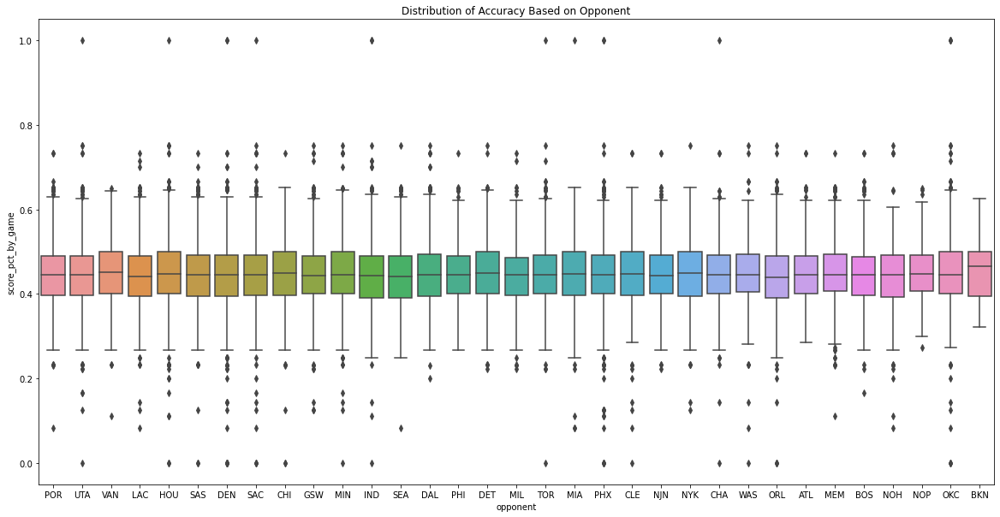

In [45]:
plt.figure(figsize = (20,10))
sns.boxplot(x = temp['opponent'], y = temp['score_pct_by_game'])
plt.title("Distribution of Accuracy Based on Opponent");

According to the shot scoring percentage by team, there is not a noticeable difference in performance based on the opponent Kobe faced. If you look at the distribution of field goal percentage on a per-team basis, there is no clear relationship.

We'll remove opponents as a predictive feature. 

### 4.7: Shot Angle

This was a late addition. After flirting with making do with the shot zone area, I decided to calculate the angle at which Kobe looked to make a shot. 

This visual may help inspire:

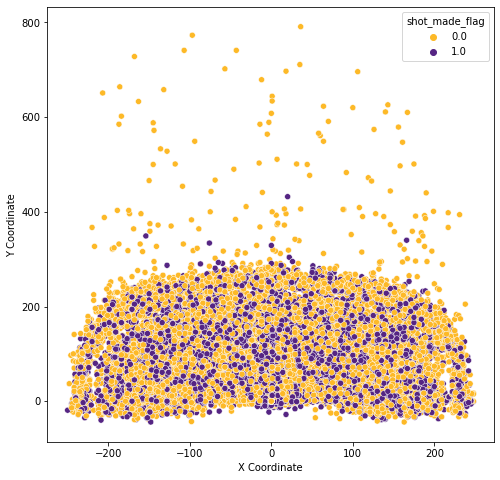

In [141]:
## Create array of Laker colors
cols = ['#FDB927','#552583']
## Transform into palette
pal = sns.color_palette(cols)
plt.figure(figsize = (8,8))
sns.scatterplot(data = Xtr, x = 'loc_x',y = 'loc_y', hue = ytr, palette = pal)
plt.xlabel("X Coordinate")
plt.ylabel("Y Coordinate");

After seeing this, it may come to mind that you can find the shot angle by utilizing three points:

1. The hoop at the origin (0,0)
2. The sideline at (250,0)
3. The point at which the shot was taken at (x, y)

Let's take one observation as an example:

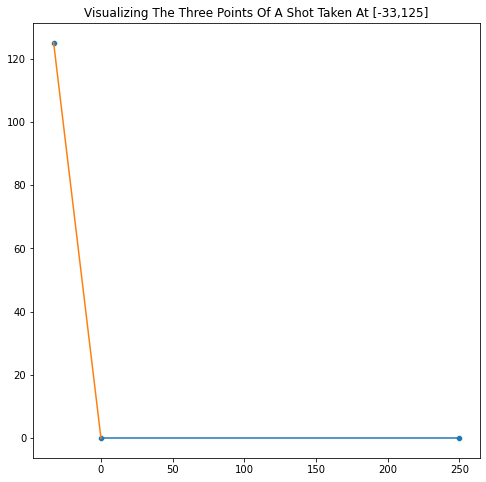

In [87]:
plt.figure(figsize = (8,8))
sns.scatterplot(x = [0, -33, 250], y = [0, 125, 0])
sns.lineplot(x = [0, 250], y = [0,0])
sns.lineplot(x = [0,-33],y = [0,125])
plt.title("Visualizing The Three Points Of A Shot Taken At [{},{}]".format(Xtr.loc_x.iloc[7],Xtr.loc_y.iloc[7]));

Now that we have our vectors, let's find the calculation of the angle between them. This is formulated through the cosine, which is reached by finding the dot product between the two vectors divided by the product of each vector's magnitude.

In [110]:
def angles(val):
    x = val[0]
    y = val[1]
    if (x == 0) & (y == 0):
        y = 1
    a = np.array([-x, y])
    b = np.array([0,0])
    c = np.array([250, 0])


    ba = b - a
    bc = c - b

    cos = np.dot(ba, bc) / (np.linalg.norm(ba) * (np.linalg.norm(bc)))
    angle = np.arccos(cos)
    result = abs(np.degrees(angle)-90)
    return result

In [95]:
angles((Xtr.loc_x.iloc[7], Xtr.loc_y.iloc[7])) + 90

104.78867761416518

It seems that the angle for the above observation was 104.79 degrees. There is a slight problem with the new feature: the relationship is parabolic. You could see this below.

In [131]:
Xtr['combo'] = Xtr[['loc_x','loc_y']].values.tolist()
Xtr['shot_angle'] = Xtr['combo'].apply(angles)
Xtr['orig_shot_angle'] = Xtr['shot_angle'] + 90

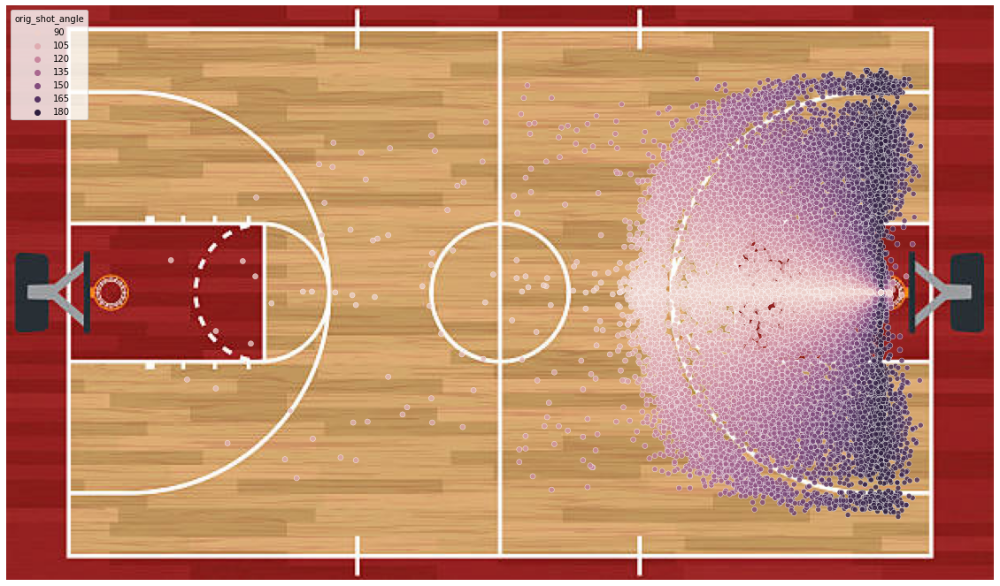

In [137]:
# Configure background image and figure size
plt.figure(figsize = (20,20))
img = plt.imread('bb_court.jpg')
plt.imshow(img, extent=[33.07,34.17,-118.59,-117.95])
plt.axis('off')

# plot data
sns.scatterplot(data = Xtr, x = 'lat', y = 'lon',  hue = 'orig_shot_angle', alpha = 0.8);

Kobe has the best chance of sinking a shot when he's directly in front of the net. In that position, he can take full advantage of the backboard. As the angle becomes more extreme (in either direction), the benefit decays. 

We fixed this by adjusting the feature to represent angles in a manner where the straight shot is 0 and anything that isn't is a higher number. We subtracted 90 from the angle and then calculated the absolute value. Shots from 90 degrees become 0, and those from 0 or 180 degrees become 90. In this way the relationship becomes a negatively correlated and linear.

In [119]:
temp = pd.concat((Xtr['shot_angle'], ytr), axis = 1)
temp['shot_made_flag'] = np.where(ytr == 1, 'Score', 'Miss')

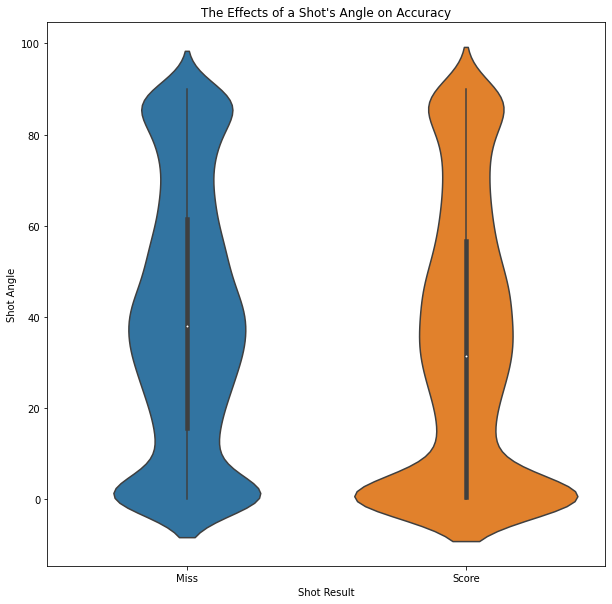

In [126]:
plt.figure(figsize = (10,10))
sns.violinplot(data = temp, x = 'shot_made_flag', y = 'shot_angle')
plt.xlabel("Shot Result")
plt.ylabel("Shot Angle")
plt.title("The Effects of a Shot's Angle on Accuracy");

We now have our shot angle feature! As a result, the lower the adjusted angle was, the more likely Kobe was to score. 

## 5: Setting up the Pipeline

### 5.1: What are our Features? (Summary)

1. Shot Type: What type of shot style did Kobe use? (layup, dunk, hook shot?)

2. Period: What point of the game did he shoot?

3. Shot Zone: At what section of the court was Kobe situated when he shot?

4. Shot Distance: How far was he from the hoop?

4. Season: At what stage of his career did he make that shot?

5. Last Second Check: Was the shot made as the clock ran out?

6. Last Minute Check: Was it made when the clock was running out?

In [7]:
from sklearn.base import BaseEstimator, TransformerMixin

class SeasonInteger(BaseEstimator, TransformerMixin):
    def __init___(self, season_int = True):
        self.season_int = season_int
    def fit(self, X, y = None):
        return self
    def transform(self, X):
        season = pd.to_numeric(X.iloc[:,11].str.replace('-..', '', regex = True))
        X.iloc[:,11] = season
        return X

class LastMin(BaseEstimator, TransformerMixin):
    def __init__(self, make_vars = True):
        self.make_vars = make_vars
    def fit(self, X, y = True):
        return self
    def transform(self, X):
        last_minute_shot = np.where(X.iloc[:,8] == 0, 1, 0)
        X.iloc[:,8] = last_minute_shot
        return X

class LastSec(BaseEstimator, TransformerMixin):
    def __init__(self, make_vars = True):
        self.make_vars = make_vars
    def fit(self, X, y = True):
        return self
    def transform(self, X):
        last_second_shot = np.where((X.iloc[:,8]== 0) & (X.iloc[:,12] == 0), 1, 0)
        X.iloc[:,12] = last_second_shot
        return X

class AngleShot(BaseEstimator, TransformerMixin):
    def __init__(self, make_vars = True):
        self.make_vars = make_vars
    def angles(val):
        x = val[0]
        y = val[1]
        if (x == 0) & (y == 0):
            y = 1
        a = np.array([-x, y])
        b = np.array([0,0])
        c = np.array([250, 0])

        ba = b - a
        bc = c - b

        cos = np.dot(ba, bc) / (np.linalg.norm(ba) * (np.linalg.norm(bc)))
        angle = np.arccos(cos)
        result = abs(np.degrees(angle) - 90)
        return result

    def fit(self, X, y = True):
        return self
    def transform(self, X):
        X['combo'] = X.iloc[:,5:7].values.tolist()
        X['shot_angle'] = X['combo'].apply(angles)
        return X


### 5.2: Transformation Functions

In [8]:
from sklearn.pipeline import make_pipeline
from sklearn.compose import make_column_transformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder

In [9]:
# cols = make_column_transformer(
#     (SeasonInteger(), 'season'),
#     (StandardScaler(),['shot_distance','period']),
#     (OneHotEncoder(), ['combined_shot_type','shot_zone_basic']),
#     ('passthrough', ['seconds_remaining','minutes_remaining'])
# )

cols = make_column_transformer(
    (StandardScaler(),['shot_distance','period','season','shot_angle']),
    (OneHotEncoder(), ['action_type']),
    ('passthrough' , ['seconds_remaining','minutes_remaining'])
)

pipes = make_pipeline(
    # Create new vars through pipeline
    SeasonInteger(),
    LastSec(),
    LastMin(),
    AngleShot(),
    # Standardize and one hot
    cols
)

### 5.3: Applying the Column Transformer to the Training Set

In [10]:
Xtr_org = Xtr
Xtr = pipes.fit_transform(Xtr)

## 6: Modeling

### 6.1: Model Evaluation Function

Now that everything is sorted, we'll begin modeling. Let's start by creating a function that will fit and apply a model of our choice before providing several evaluation metrics to guage each model's predictive power. 

In [11]:
from sklearn.model_selection import cross_val_score

def get_cross_val_scores(mod, Xtrain, ytrain):
    ## Stratified KFold - 20 splits
    accscores = cross_val_score(mod, Xtrain, ytrain, scoring = 'accuracy',cv = 20)
    f1scores = cross_val_score(mod, Xtrain, ytrain, scoring = 'f1', cv = 20)

    return [accscores, f1scores]

def describe_accuracy(scores):
    print('Accuracy Scores: ', scores[0], '\n')
    print('Accuracy Mean Score: ', scores[0].mean())
    print('Accuracy Scores STD: ', scores[0].std(), '\n','\n')

def describe_f1score(scores):
    print('F1 Scores: ', scores[1], '\n')
    print('F1 Mean Score: ', scores[1].mean())
    print('F1 Scores STD: ', scores[1].std(), '\n')

def display_scores(scores):
    fig, (ax1, ax2) = plt.subplots(1,2, figsize = (20,10))
    sns.set_palette(sns.color_palette("Set2"))
    sns.histplot(scores[0], bins = 10, ax = ax1)
    sns.histplot(scores[1], bins = 10, ax = ax2)
    ax1.title.set_text('Accuracy Distribution')
    ax2.title.set_text("F1 Distribution")
    plt.suptitle("Distribution of Scores");

We picked accuracy as a baseline metric due to its comparability. We'll also provide a confusion matrix, the F1-Score (which incorporates both Precision and Recall), and a visualization of the latter. 

### 6.2: Dummy Classifier

In [12]:
from sklearn.dummy import DummyClassifier

dum = DummyClassifier()
sc = get_cross_val_scores(dum, Xtr, ytr)

describe_accuracy(sc)
describe_f1score(sc)

Accuracy Scores:  [0.4770428  0.48015564 0.52062257 0.49027237 0.50350195 0.51595331
 0.49182879 0.49494163 0.49416342 0.50194553 0.52140078 0.50817121
 0.50505837 0.48949416 0.50583658 0.51206226 0.51906615 0.52725857
 0.48909657 0.52024922] 

Accuracy Mean Score:  0.5034060935549172
Accuracy Scores STD:  0.014285386685877623 
 

F1 Scores:  [0.48107653 0.44444444 0.43881119 0.44327177 0.44638187 0.45106383
 0.4529991  0.43766347 0.4677558  0.45873154 0.41166078 0.43766347
 0.45263158 0.43661972 0.43130435 0.4552563  0.49873204 0.43971631
 0.4560205  0.46208113] 

F1 Mean Score:  0.45019428562348
F1 Scores STD:  0.01814001015140698 



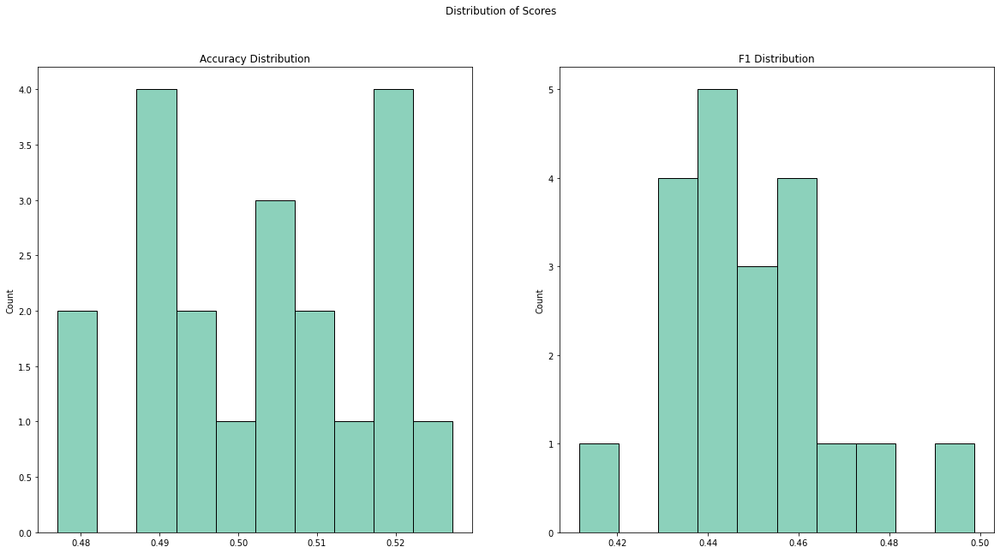

In [13]:
display_scores(sc)

As expected, the model performed poorly. We will at least be able to compare more complicated models against it.

### 6.3: Decision Tree Classifier

In [14]:
from sklearn.tree import DecisionTreeClassifier

dt = DecisionTreeClassifier()
sc = get_cross_val_scores(dt, Xtr, ytr)

describe_accuracy(sc)
describe_f1score(sc)

Accuracy Scores:  [0.56964981 0.6077821  0.6        0.5766537  0.58754864 0.58754864
 0.59299611 0.58832685 0.59455253 0.59066148 0.5307393  0.54474708
 0.507393   0.47470817 0.56342412 0.5618677  0.57976654 0.59735202
 0.59813084 0.57398754] 

Accuracy Mean Score:  0.5713918081869643
Accuracy Scores STD:  0.03300218756656798 
 

F1 Scores:  [0.52347826 0.56392887 0.54545455 0.54268808 0.53160173 0.53061224
 0.54466609 0.54782609 0.56616415 0.5372617  0.44919786 0.42954325
 0.36935167 0.333001   0.1826215  0.50741064 0.54498715 0.5472028
 0.55754476 0.52804142] 

F1 Mean Score:  0.4941291896993782
F1 Scores STD:  0.09525173288269582 



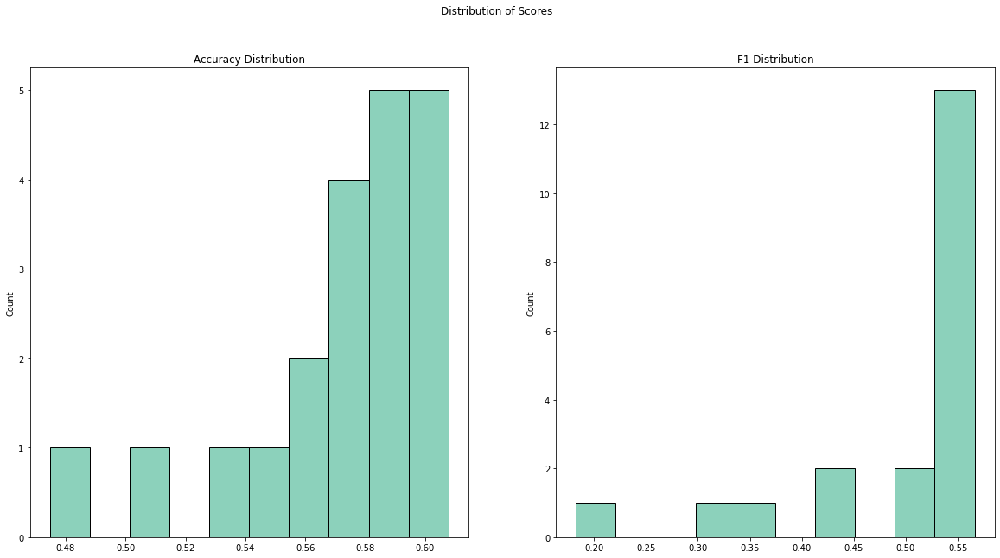

In [15]:
display_scores(sc)

The decision tree performed markedly better than the baseline, but 60% is not too exciting either. That said, we have more powerful models coming up.

### 6.4: KNN 

In [16]:
from sklearn.neighbors import KNeighborsClassifier
kn = KNeighborsClassifier(n_neighbors=4)
sc = get_cross_val_scores(kn, Xtr, ytr)

describe_accuracy(sc)
describe_f1score(sc)

Accuracy Scores:  [0.64357977 0.63579767 0.61167315 0.61712062 0.61011673 0.62957198
 0.63424125 0.63268482 0.64357977 0.61322957 0.6077821  0.62256809
 0.58132296 0.61478599 0.6155642  0.6381323  0.64435798 0.62694704
 0.66121495 0.5817757 ] 

Accuracy Mean Score:  0.6233023322060196
Accuracy Scores STD:  0.019555976864566334 
 

F1 Scores:  [0.50858369 0.51950719 0.47528917 0.49382716 0.46186896 0.47577093
 0.51041667 0.4957265  0.53923541 0.4912999  0.46947368 0.4768069
 0.40354767 0.46945338 0.36010363 0.48160535 0.53224156 0.48660236
 0.55015512 0.41439477] 

F1 Mean Score:  0.4807954987981117
F1 Scores STD:  0.044826149783616445 



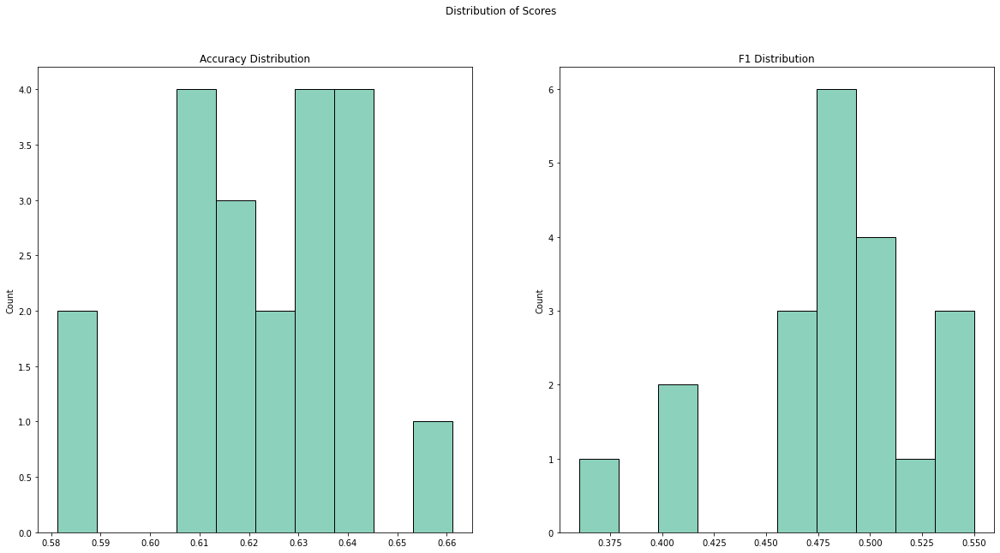

In [17]:
display_scores(sc)

### 6.5: Logistic Regression

In [18]:
from sklearn.linear_model import LogisticRegression

logit = LogisticRegression()
sc = get_cross_val_scores(logit, Xtr, ytr)

describe_accuracy(sc)
describe_f1score(sc)

Accuracy Scores:  [0.68326848 0.69883268 0.70194553 0.67470817 0.70194553 0.67392996
 0.68171206 0.70116732 0.69727626 0.68093385 0.68326848 0.67159533
 0.63346304 0.68560311 0.65291829 0.68793774 0.68171206 0.69003115
 0.68535826 0.65809969] 

Accuracy Mean Score:  0.6812853497702946
Accuracy Scores STD:  0.01702560033501738 
 

F1 Scores:  [0.5452514  0.59561129 0.5701459  0.55531915 0.57865787 0.51108518
 0.53785311 0.56756757 0.59436913 0.58502024 0.59901478 0.57287449
 0.51791198 0.62172285 0.57115385 0.55788313 0.53785311 0.57478632
 0.57563025 0.52021858] 

F1 Mean Score:  0.5644965084136924
F1 Scores STD:  0.028491958765151024 



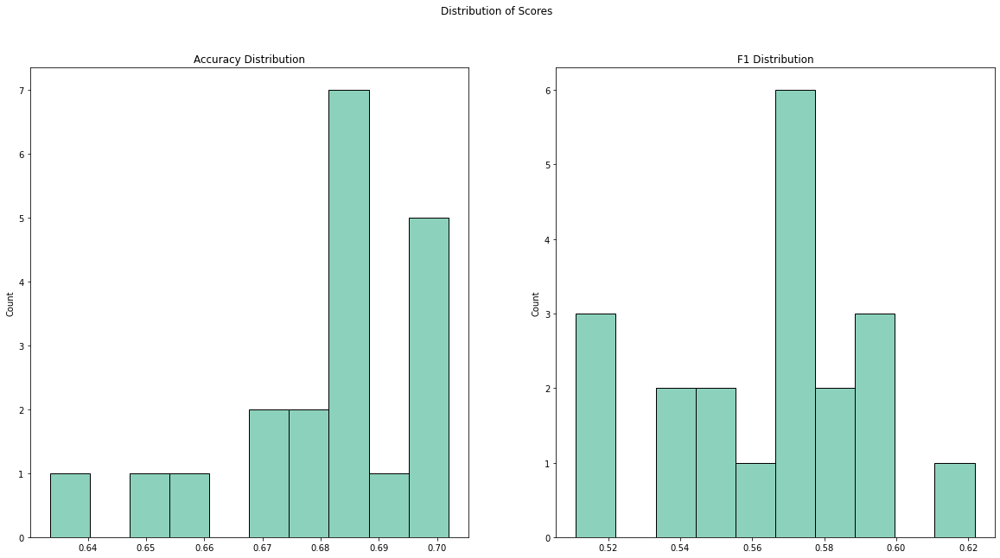

In [19]:
display_scores(sc)

Another noticeable improvement. Let's see if we can do better. 

### 6.6: Naive Bayes

In [24]:
from sklearn.naive_bayes import BernoulliNB
mnb = BernoulliNB()
sc = get_cross_val_scores(mnb, Xtr, ytr)

describe_accuracy(sc)
describe_f1score(sc)

Accuracy Scores:  [0.66692607 0.67315175 0.66459144 0.64669261 0.65603113 0.65525292
 0.64435798 0.66459144 0.65836576 0.64980545 0.66303502 0.68093385
 0.64202335 0.67859922 0.65136187 0.66225681 0.68404669 0.66043614
 0.66043614 0.64096573] 

Accuracy Mean Score:  0.6601930676267016
Accuracy Scores STD:  0.012178194604767637 
 

F1 Scores:  [0.5694165  0.61182994 0.5633232  0.59172662 0.58998145 0.54376931
 0.54886476 0.5745311  0.59389454 0.59677419 0.62117235 0.61682243
 0.57328386 0.6491079  0.5942029  0.59056604 0.5915493  0.58867925
 0.59099437 0.55111977] 

F1 Mean Score:  0.587580488473024
F1 Scores STD:  0.025126311843761177 



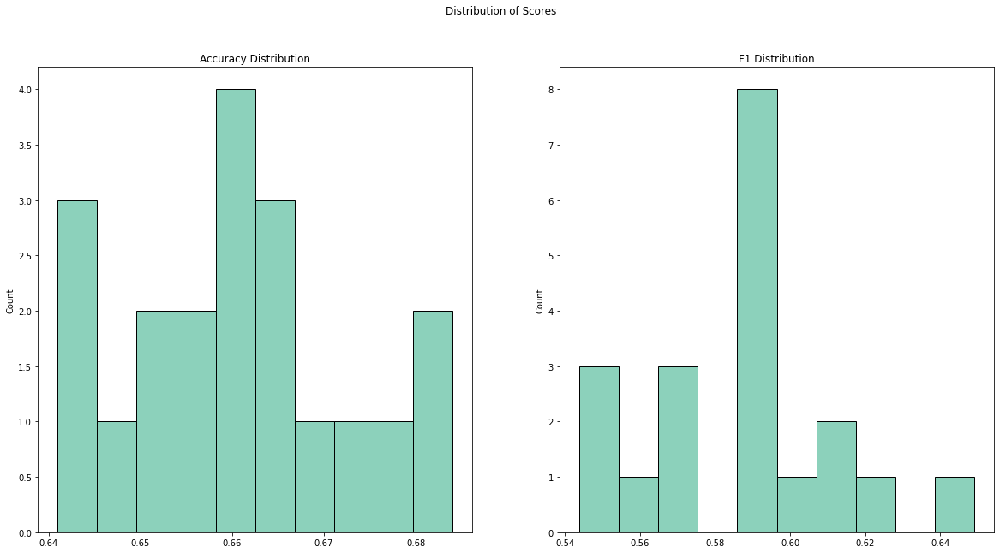

In [25]:
display_scores(sc)

### 6.7: SVM

In [238]:
from sklearn.svm import SVC

svc = SVC()
sc = get_cross_val_scores(svc, Xtr, ytr)

describe_accuracy(sc)
describe_f1score(sc)

Accuracy Scores:  [0.68249027 0.69883268 0.70194553 0.67392996 0.70038911 0.67470817
 0.68249027 0.69961089 0.69961089 0.67782101 0.68093385 0.67470817
 0.62412451 0.68015564 0.65603113 0.68793774 0.68326848 0.68847352
 0.68847352 0.65732087] 

Accuracy Mean Score:  0.6806628119810417
Accuracy Scores STD:  0.018099020204298513 
 

F1 Scores:  [0.54464286 0.59729448 0.57206704 0.55472901 0.57923497 0.51508121
 0.5426009  0.56726457 0.5987526  0.58266129 0.60038986 0.57862903
 0.50562948 0.62258953 0.54338843 0.55982437 0.54320988 0.57264957
 0.58158996 0.51754386] 

F1 Mean Score:  0.5639886451505058
F1 Scores STD:  0.030065715225293242 



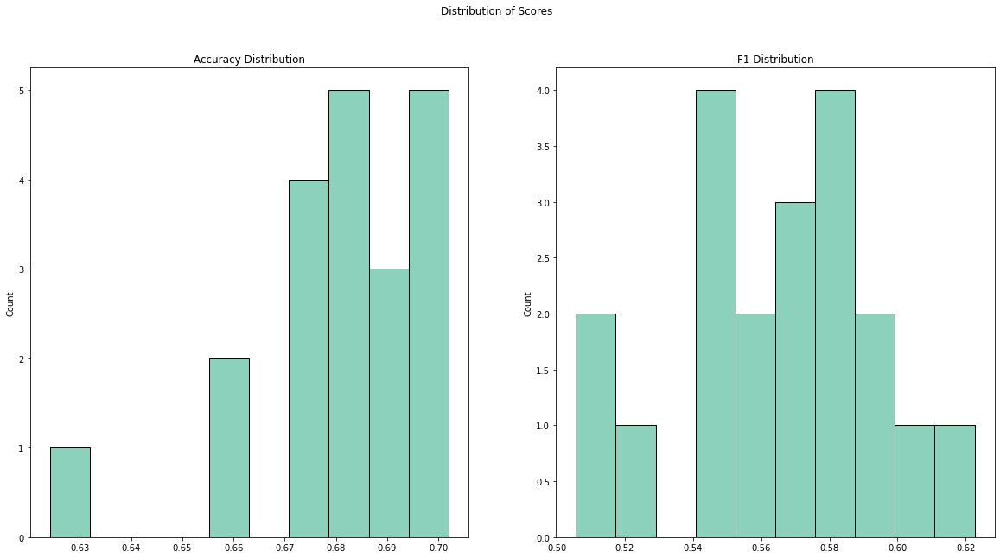

In [239]:
display_scores(sc)

The SVM's predictive power was comparable to the Logistic Regresssor. 

### 6.8: Random Forest Classifier

In [26]:
from sklearn.ensemble import RandomForestClassifier

rfc = RandomForestClassifier()
sc = get_cross_val_scores(rfc, Xtr, ytr)

describe_accuracy(sc)
describe_f1score(sc)

Accuracy Scores:  [0.62101167 0.64124514 0.6459144  0.60466926 0.6459144  0.62879377
 0.61478599 0.62412451 0.63190661 0.62568093 0.57976654 0.57354086
 0.56031128 0.58054475 0.58365759 0.60700389 0.63501946 0.64953271
 0.6682243  0.61604361] 

Accuracy Mean Score:  0.6168845836818309
Accuracy Scores STD:  0.028246494539813417 
 

F1 Scores:  [0.56175663 0.57611668 0.5625     0.55585344 0.57329599 0.54138267
 0.55115207 0.56358646 0.59417808 0.56086564 0.49490269 0.44329897
 0.42915811 0.46301633 0.159375   0.51928504 0.60779221 0.59543379
 0.60600546 0.53544776] 

F1 Mean Score:  0.5247201513687758
F1 Scores STD:  0.09746169367916604 



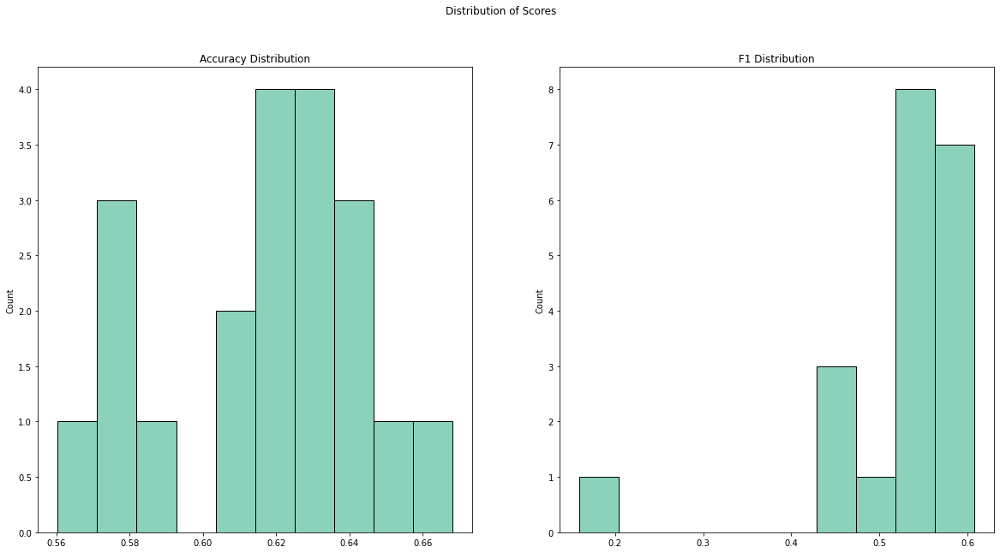

In [27]:
display_scores(sc)

### 6.8: Adaboost

In [242]:
from sklearn.ensemble import AdaBoostClassifier

ada = AdaBoostClassifier()
sc = get_cross_val_scores(ada, Xtr, ytr)

describe_accuracy(sc)
describe_f1score(sc)

Accuracy Scores:  [0.68249027 0.69805447 0.70038911 0.67470817 0.69883268 0.67470817
 0.68249027 0.70116732 0.69727626 0.67937743 0.68171206 0.64046693
 0.62568093 0.62256809 0.56264591 0.68793774 0.68404669 0.68925234
 0.6876947  0.65732087] 

Accuracy Mean Score:  0.6714410220977733
Accuracy Scores STD:  0.03374303739258894 
 

F1 Scores:  [0.54464286 0.59583333 0.56886898 0.55531915 0.5751921  0.51508121
 0.54157303 0.56853933 0.59436913 0.58299595 0.5938431  0.48666667
 0.47887324 0.45444319 0.05387205 0.55982437 0.54279279 0.57417289
 0.58010471 0.52069717] 

F1 Mean Score:  0.5243852627732453
F1 Scores STD:  0.11477839386554263 



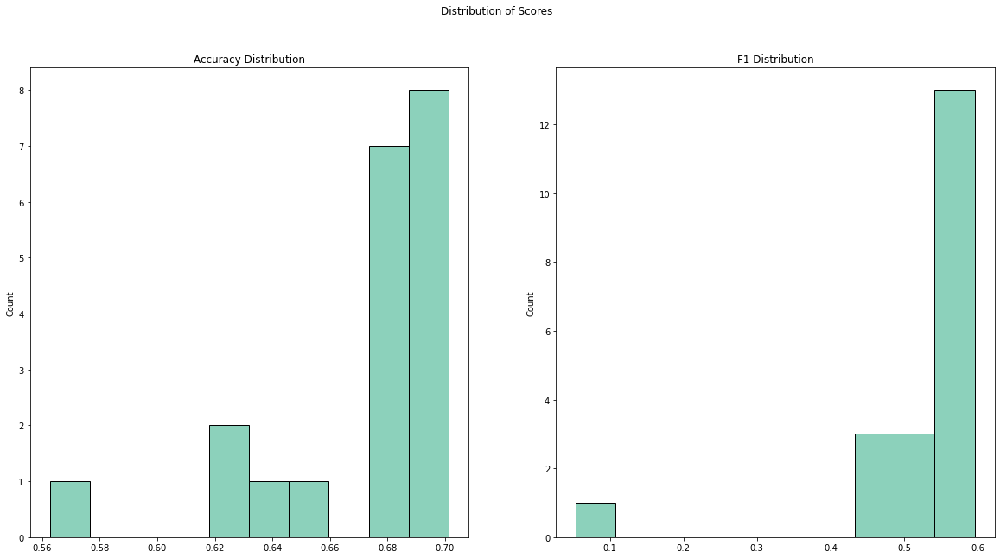

In [243]:
display_scores(sc)

### 6.9: Xgboost

In [112]:
from xgboost import XGBClassifier
xg = XGBClassifier()
sc = get_cross_val_scores(xg, Xtr, ytr)
describe_accuracy(sc)
describe_f1score(sc)

Accuracy Scores:  [0.67782101 0.68015564 0.69338521 0.67237354 0.67937743 0.65914397
 0.67782101 0.69571984 0.66225681 0.64357977 0.62256809 0.55797665
 0.5688716  0.48404669 0.57042802 0.67159533 0.66459144 0.68380062
 0.68068536 0.63551402] 

Accuracy Mean Score:  0.6440856031128405
Accuracy Scores STD:  0.054780032499049565 
 

F1 Scores:  [0.57841141 0.59104478 0.598778   0.5591623  0.56355932 0.50675676
 0.54901961 0.57174151 0.57199211 0.54108216 0.52404318 0.28101266
 0.35280374 0.35190616 0.09210526 0.54329004 0.5745311  0.57531381
 0.57112971 0.5010661 ] 

F1 Mean Score:  0.49993748557446543
F1 Scores STD:  0.12705753326673358 



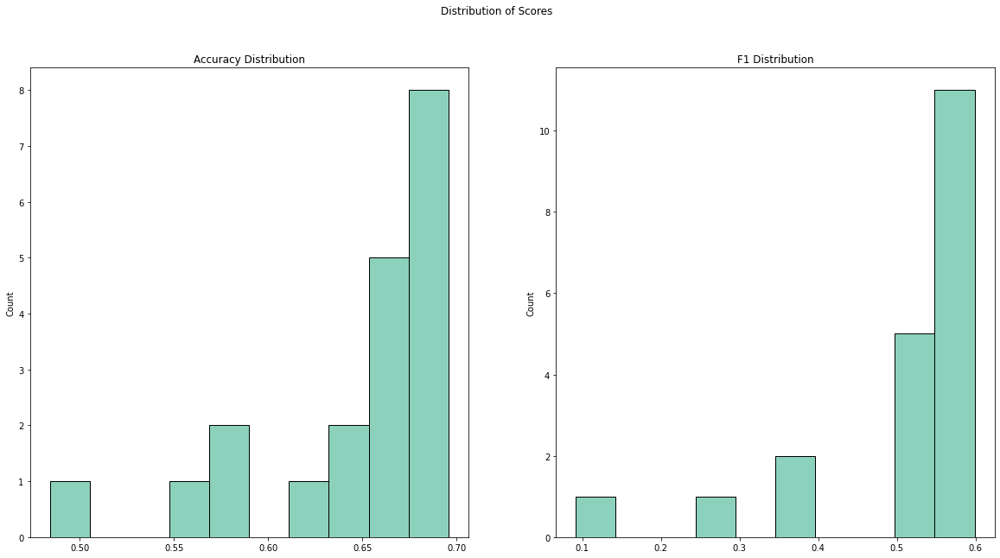

In [113]:
display_scores(sc)

### 6.10: Feature Importance

In [28]:
rfc.fit(Xtr, ytr)
temp = pd.DataFrame(Xtr.todense())
feat_importance = pd.concat((pd.DataFrame(temp.columns), pd.DataFrame(rfc.feature_importances_)), axis = 1)
feat_importance.columns = ['Feature','Importance']

actshot = [str(x) for x in range(len(Xtr_org['action_type'].unique()))]
actshot = ['action_type_' + x for x in actshot]
names = pd.concat((pd.Series(['shot_distance','period','season','shot_angle']), pd.Series(actshot), pd.Series(['last_second', 'last_minute'])), axis = 0)

feat_importance.reset_index(drop = True, inplace = True)
names.reset_index(drop = True, inplace = True)
feat_importance['Feature'] = names

In [29]:
feat_importance.sort_values(by = 'Importance', ascending= False).head(10)

,Feature,Importance
3,shot_angle,0.460363
2,season,0.166833
0,shot_distance,0.165205
29,action_type_25,0.054000
1,period,0.048896
30,action_type_26,0.020660
15,action_type_11,0.011786
44,action_type_40,0.007660
60,last_minute,0.007498
50,action_type_46,0.007455


# TODO
1. Revisit Feature Engineering (Action Type & Time within Game)
2. Finish Stacking Ensemble
3. Apply to Test Set